In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates
import plotly.express as px

In [9]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [10]:
# Import csv files:
data_apr= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-apr14.csv')
data_may= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-may14.csv')
data_jun= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-jun14.csv')
data_jul= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-jul14.csv')
data_aug= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-aug14.csv')
data_sep= pd.read_csv('/content/drive/MyDrive/MS/Data Visualization/Project/Uber_Data/uber-raw-data-sep14.csv')
uber_data= pd.concat([data_apr,data_may,data_jun, data_jul,data_aug,data_sep])

In [16]:
uber_data.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


## Examining data for April 2014

In [ ]:
# Convert Date/Time column to datetime type:
data_apr['Date/Time'] = pd.to_datetime(data_apr['Date/Time'])

# Add two new columns of Date and Hours:
data_apr['Date'] = data_apr['Date/Time'].dt.date
data_apr['Hour'] = data_apr['Date/Time'].dt.hour
data_apr['Day_of_Week']= data_apr['Date/Time'].dt.strftime('%A')

# Calculate counts of occurrences of Dates and Hours:
date_counts = data_apr['Date'].value_counts().sort_index()
hour_counts = data_apr['Hour'].value_counts().sort_index()
day_counts = data_apr['Day_of_Week'].value_counts()

In [ ]:
data_apr.head()

,Date/Time,Lat,Lon,Base,Date,Hour,Day_of_Week
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,2014-04-01,0,Tuesday
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,2014-04-01,0,Tuesday
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2014-04-01,0,Tuesday
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2014-04-01,0,Tuesday
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,2014-04-01,0,Tuesday


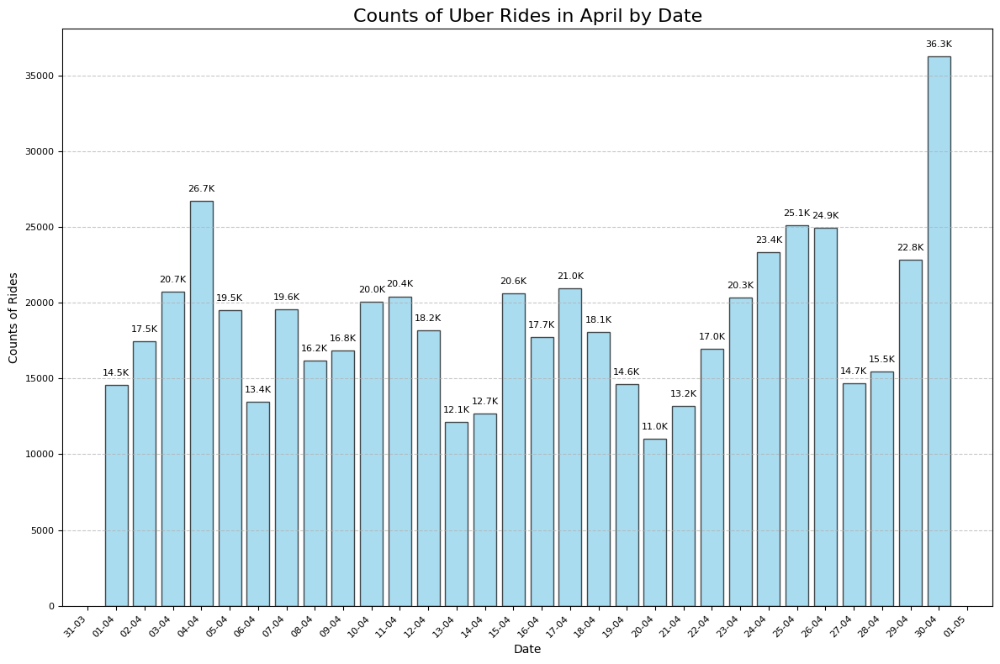

In [ ]:
# Create a bar plot of Dates:
plt.figure(figsize=(12, 8))
plt.bar(date_counts.index, date_counts.values, color='skyblue', edgecolor='black', alpha=0.7)

# Beautify the x-axis by formatting dates
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m'))

plt.xlabel('Date')
plt.ylabel('Counts of Rides')

# Add annotation on top of each bar
for i, value in enumerate(date_counts.values):
    plt.text(date_counts.index[i], value + 500, f"{value/1000:.1f}K", ha='center', va='bottom', fontsize=8, color='black')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.title('Counts of Uber Rides in April by Date', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=8)
plt.yticks(fontsize=8)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

plt.show()

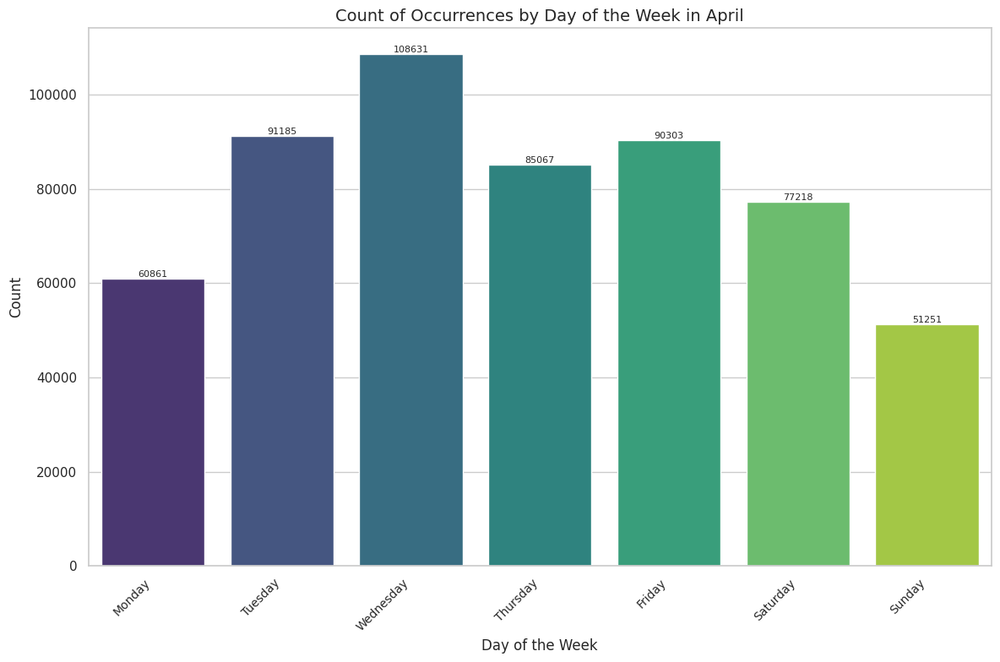

In [ ]:
# Sort the counts of Days from Monday to Sunday:
days_in_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_counts = day_counts.reindex(days_in_order)

# Set a Seaborn style for a more visually appealing plot
sns.set(style="whitegrid")

# Make a bar plot with color palette
plt.figure(figsize=(12, 8))
sns.barplot(x=day_counts.index, y=day_counts.values, palette="viridis")

# Reset the x-axis label:
plt.xlabel('Day of the Week', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)

plt.ylabel('Count', fontsize=12)

# Add annotation on top of each bar
for i, value in enumerate(day_counts.values):
    plt.text(i, value + 5, str(value), ha='center', va='bottom', fontsize=8)

plt.title('Count of Occurrences by Day of the Week in April', fontsize=14)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

plt.show()

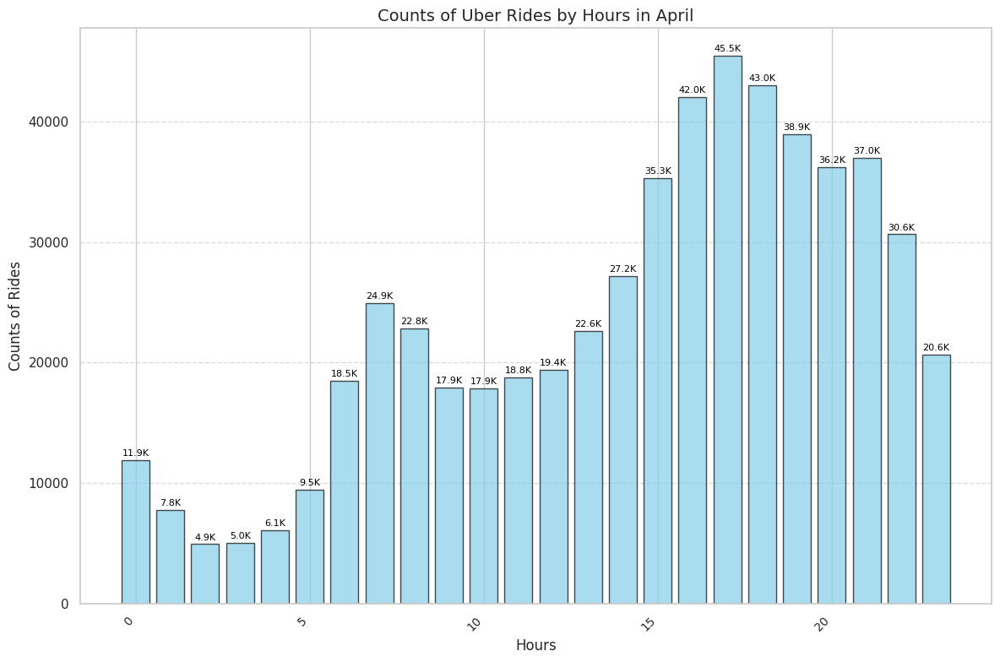

In [ ]:
# Set a Seaborn style for a more visually appealing plot
sns.set(style="whitegrid")

# Create a bar plot for Hours:
plt.figure(figsize=(12, 8))
plt.bar(hour_counts.index, hour_counts.values, color='skyblue', edgecolor='black', alpha=0.7)

# Beautify the x-axis by adjusting ticks
plt.xlabel('Hours', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)

plt.ylabel('Counts of Rides', fontsize=12)

# Add annotation on top of each bar
for i, value in enumerate(hour_counts.values):
    plt.text(hour_counts.index[i], value + 200, f"{value/1000:.1f}K", ha='center', va='bottom', fontsize=8, color='black')

# Add a horizontal grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.title('Counts of Uber Rides by Hours in April', fontsize=14)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

plt.show()

**Observation 1 -- from April 2014 Data**
Based on the plot of count of Uber rides by day of the week in April 2014 in NYC,

it appears that Monday and Sunday have the least counts, while Tuesday and Wednesday have the most rides.

Additionally, the plot indicates that approximately 60% of rides occurred between 14:00 - 21:00.

## Examing All Data from April to September

In [17]:
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])

# Add two new columns of Date and Hours:
uber_data['Date'] = uber_data['Date/Time'].dt.date
uber_data['Month']=uber_data['Date/Time'].dt.month
uber_data['Day']=uber_data['Date/Time'].dt.day
uber_data['Hour'] = uber_data['Date/Time'].dt.hour
uber_data['Minute']=uber_data['Date/Time'].dt.minute
uber_data['Day_of_Week']= uber_data['Date/Time'].dt.strftime('a%A')
uber_data['Day_of_Week']= uber_data['Day_of_Week'].str[1:]

# Calculate counts of occurrences of Dates and Hours:
date_counts_concat = uber_data['Date'].value_counts().sort_index()
hour_counts_concat = uber_data['Hour'].value_counts().sort_index()

day_counts_concat = uber_data['Day_of_Week'].value_counts()

In [18]:
uber_data.head()

,Date/Time,Lat,Lon,Base,Date,Month,Day,Hour,Minute,Day_of_Week
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,2014-04-01,4,1,0,11,Tuesday
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,2014-04-01,4,1,0,17,Tuesday
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,2014-04-01,4,1,0,21,Tuesday
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,2014-04-01,4,1,0,28,Tuesday
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,2014-04-01,4,1,0,33,Tuesday


In [ ]:
unique_bases = uber_data['Base'].unique()
print(unique_bases)

['B02512' 'B02598' 'B02617' 'B02682' 'B02764']


In [ ]:
base_map= {
    'B02512': 'Unter',
    'B02598': 'Hinter',
    'B02617': 'Weiter',
    'B02682': 'Schmecken',
    'B02764': 'Danach-NY'}

uber_data['Base']= uber_data['Base'].map(base_map)

In [ ]:
uber_data.head()

,Date/Time,Lat,Lon,Base,Date,Month,Day,Hour,Minute,Day_of_Week
0,2014-04-01 00:11:00,40.7690,-73.9549,Unter,2014-04-01,4,1,0,11,Tuesday
1,2014-04-01 00:17:00,40.7267,-74.0345,Unter,2014-04-01,4,1,0,17,Tuesday
2,2014-04-01 00:21:00,40.7316,-73.9873,Unter,2014-04-01,4,1,0,21,Tuesday
3,2014-04-01 00:28:00,40.7588,-73.9776,Unter,2014-04-01,4,1,0,28,Tuesday
4,2014-04-01 00:33:00,40.7594,-73.9722,Unter,2014-04-01,4,1,0,33,Tuesday


###01. Which month and day of the month sees the highest number of uber trips?

In [ ]:
# Sample data
df = pd.DataFrame(uber_data)

# Calculate counts of occurrences of Days and Months
weekday = pd.DataFrame(df[['Day', 'Month']].value_counts()).reset_index()
weekday.columns = ['Day', 'Month', 'Count']
weekday['Day'] = pd.Categorical(weekday['Day'], categories=range(1, 32), ordered=True)
weekday['Month'] = pd.Categorical(weekday['Month'], categories=[4, 5, 6, 7, 8, 9], ordered=True)

# Create an interactive bar plot
fig = px.bar(weekday,
             x='Day',
             y='Count',
             color='Month',
             template='seaborn',
             labels={'Count': 'Number of Trips', 'Day': 'Day of the Month'},
             width=1500,
             height=600,
             category_orders={"Month": [4, 5, 6, 7, 8, 9]},
             color_discrete_sequence=['#2C2C3E', '#2E5467', '#1E7F84', '#33AC8D', '#78D584', '#D1FA74'],
             text='Count')

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_layout(title_text='Uber trip by Months and Days', title_x=0.5)

fig.show()

In [ ]:
# Convert date index to string for better hover display
date_counts_concat.index = date_counts_concat.index.astype(str)

# Create an interactive line plot of Dates using plotly express:
fig = px.line(x=date_counts_concat.index, y=date_counts_concat.values,
              labels={'x': 'Date', 'y': 'Counts of Rides'},
              title='Counts of Uber Rides from April to September by Date')

# Update marker size, color, and line style for better aesthetics
fig.update_traces(marker=dict(size=10, color='skyblue'), line_shape='linear', line=dict(color='darkblue'))

# Update hover template to display date and count with a bold font
fig.update_traces(hovertemplate='<b>Date</b>: %{x}<br><b>Count</b>: %{y}')

# Beautify the x-axis by formatting dates
fig.update_xaxes(type='category')

# Update layout for better appearance
fig.update_layout(
    title=dict(text='Counts of Uber Rides from April to September by Date', x=0.5, y=0.98),
    xaxis_title=dict(standoff=10),
    yaxis_title=dict(standoff=10),
    font=dict(family='Arial', size=12, color='black'),
    paper_bgcolor='lightgray',
)

# Show the interactive plot
fig.show()

13th September 2014 sees the highest number of trips!

###02. Which is the busiest hour in the day for uber cabs?

In [ ]:
hour=pd.DataFrame(uber_data['Hour'].value_counts()).reset_index()
hour.columns=['Hour','Count']
hour=hour.sort_values(by='Hour')

In [ ]:
fig2=px.bar(hour,
      x='Hour',
      y='Count',
      template='seaborn',
      labels={'Count':'Number of Trips'},
      height=600,
      width=1500,
      text='Count'
      )
#fig2.update_traces(texttemplate='%{text:.1s}', textposition='outside')
#fig2.update_layout(title_text='Uber Rides by hour',title_x=0.5)
fig2.show()

Maximum number of rides are taken between 4-7 PM in a day

### 03. Distribution of Trips By Days in a Month

In [ ]:
trips_by_days=pd.DataFrame(uber_data['Day'].value_counts()).reset_index()
trips_by_days.columns=['Days','Number of Trips']
trips_by_days=trips_by_days.sort_values(by='Days')

In [ ]:
fig3 = px.histogram(trips_by_days,
                    x='Days',
                    y='Number of Trips',
                    height=600,
                    width=1500,
                    nbins=31,
                    template='seaborn',
                    color_discrete_sequence=['#C78845'])

# Add text annotations to each bar
for day, trips in zip(trips_by_days['Days'], trips_by_days['Number of Trips']):
    # Format the trips number with K suffix
    trips_text = f'{trips/1000:.0f}K'

    fig3.add_annotation(
        x=day,
        y=trips,
        text=trips_text,
        showarrow=True,
        arrowhead=3,
        ax=0,
        ay=-30
    )

fig3.update_layout(bargap=0.2)
fig3.update_layout(title_text='Distribution of trips by days in a Month', title_x=0.5)
fig3.show()


**Day 30 has the miximum number of trips**

### 04. Base locations with highest number of pickups

In [ ]:
trips_by_loc=uber_data[['Base','Hour']].value_counts().reset_index()
trips_by_loc.columns=['Base','Hour','Number of Trips']
trips_by_loc

,Base,Hour,Number of Trips
0,Weiter,17,107590
1,Hinter,17,104759
2,Weiter,18,104196
3,Hinter,18,101050
4,Weiter,16,99353
...,...,...,...
115,Danach-NY,3,2798
116,Unter,1,2149
117,Unter,4,1815
118,Unter,3,1582


In [ ]:
fig4=px.scatter(trips_by_loc,
            x='Hour',
            y='Number of Trips',
            color='Base',
            template='plotly_dark',
            color_discrete_sequence=['#50F9F1','#6AE5A8','#96C96A','#B7AA47','#C78845'])
fig4.update_layout(title_text='Trips by location and time of the day', title_x=0.5)
fig4.show()


### 05. Cross Analysis between hours and weekdays

In [ ]:
hour_week=uber_data.groupby(['Day_of_Week','Hour']).count()['Date/Time']
hour_week

Day_of_Week  Hour
Friday       0       13716
             1        8163
             2        5350
             3        6930
             4        8806
                     ...  
Wednesday    19      47017
             20      47772
             21      44553
             22      32868
             23      18146
Name: Date/Time, Length: 168, dtype: int64

In [ ]:
pivot=hour_week.unstack()
pivot

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day_of_Week,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


In [ ]:
# Assuming 'pivot' is a DataFrame for the heatmap
fig = px.imshow(pivot,
                color_continuous_scale='blues',  # Similar to seaborn's 'Blues'
                labels=dict(x="Hour", y="Day of Week", color="Values"))

# Customize layout
fig.update_layout(title='Interactive Heatmap', autosize=False, width=800, height=800)

# Show the plot
fig.show()

## Peaks and Pits

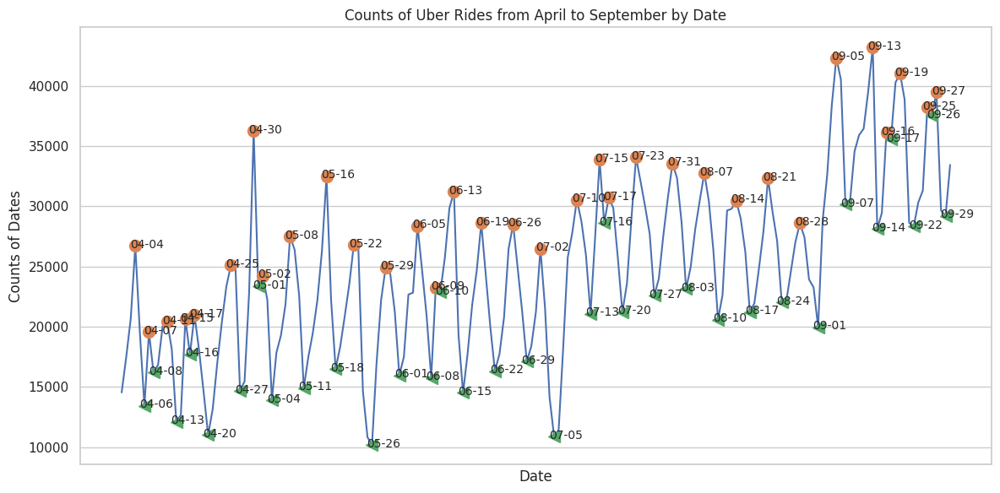

In [ ]:
# Create a line plot of Dates:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(date_counts_concat.index, date_counts_concat.values)
ax.set_xlabel('Date')
ax.set_ylabel('Counts of Dates')
ax.set_title('Counts of Uber Rides from April to September by Date')

# Get the indices of peaks and pits in the data:
from scipy.signal import find_peaks
peaks, _ = find_peaks(date_counts_concat.values)
pits, _ = find_peaks(-date_counts_concat.values)
peaks_and_pits = np.sort(np.concatenate([peaks, pits]))

# Add markers at the peaks and pits:
ax.plot(date_counts_concat.index[peaks], date_counts_concat.values[peaks], 'o', markersize=10, label='Peaks')
ax.plot(date_counts_concat.index[pits], date_counts_concat.values[pits], '<', markersize=10, label='Pits')

# Add annotations with the corresponding dates at the peaks and pits:
for i in range(len(peaks_and_pits)):
    ax.annotate(date_counts_concat.index[peaks_and_pits[i]].strftime('%m-%d'),
                xy=(date_counts_concat.index[peaks_and_pits[i]], date_counts_concat.values[peaks_and_pits[i]]),
                xytext=(10,6),
                textcoords='offset points',
                fontsize= 10,
                ha='center',
                va='top')
                #bbox= dict(boxstyle='round',facecolor='white'))

ax.set_xticks([])
plt.tight_layout()

plt.show()

In [ ]:
peak_days_of_week= []

for i in peaks:
    peak_date= date_counts_concat.index[i]
    peak_day_of_week= peak_date.strftime('%A')
    peak_days_of_week.append(peak_day_of_week)

peak_days, counts= np.unique(peak_days_of_week, return_counts= True)

peak_df= pd.DataFrame(data=counts, index=peak_days, columns=['Counts'])
days_label= ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

peak_df= peak_df.reindex(days_label)
peak_df.fillna(0, inplace=True)
peak_df['Counts']= peak_df['Counts'].astype(int)

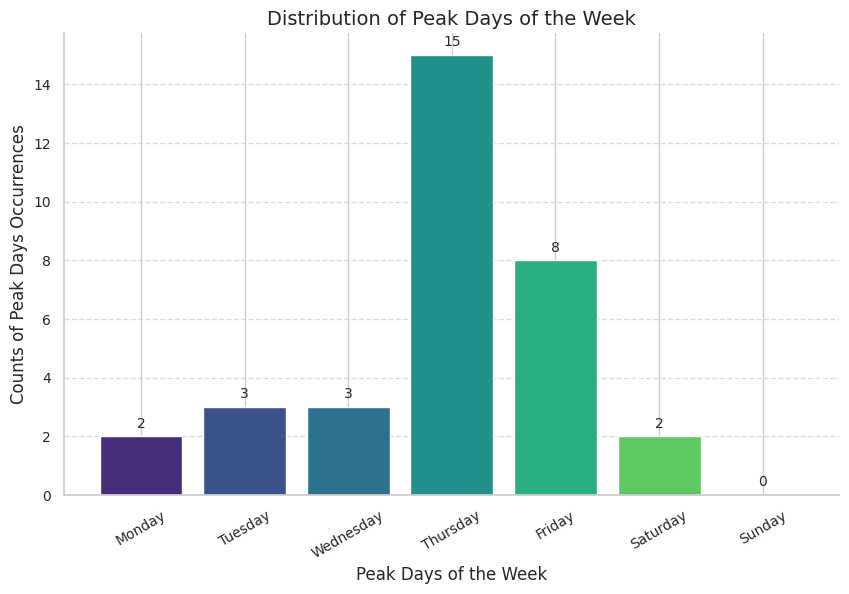

In [ ]:
# Set a color palette for the bars
colors = sns.color_palette("viridis", len(peak_df))

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(peak_df.index, peak_df['Counts'], color=colors)

# Add value annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.2, int(yval), ha='center', va='bottom', fontsize=10)

# Customize plot aesthetics
plt.xlabel('Peak Days of the Week', fontsize=12)
plt.ylabel('Counts of Peak Days Occurrences', fontsize=12)
plt.title('Distribution of Peak Days of the Week', fontsize=14)
plt.xticks(rotation=30, ha='center', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Remove top and right spines for cleaner appearance
sns.despine()

# Show the plot
plt.show()

In [ ]:
pits_days_of_week= []

for i in pits:
    pits_date= date_counts_concat.index[i]
    pits_day_of_week= peak_date.strftime('%A')
    pits_days_of_week.append(pits_day_of_week)

pits_days, counts= np.unique(pits_days_of_week, return_counts= True)

pits_df= pd.DataFrame(data=counts, index=pits_days, columns=['Counts'])
days_label= ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

pits_df= pits_df.reindex(days_label)
pits_df.fillna(0, inplace=True)
pits_df['Counts']= pits_df['Counts'].astype(int)

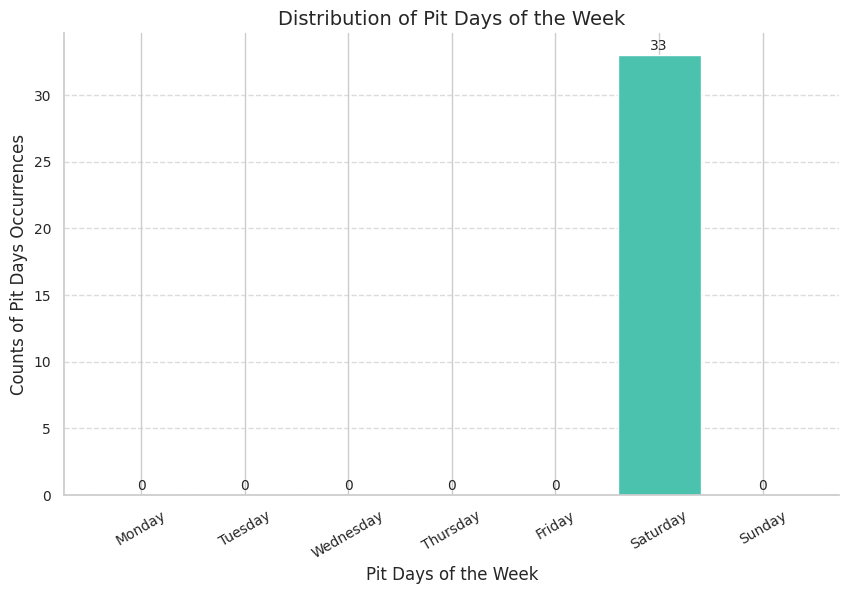

In [ ]:
# Set a color palette for the bars
colors = sns.color_palette("mako", len(pits_df))

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(pits_df.index, pits_df['Counts'], color=colors)

# Add value annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.2, int(yval), ha='center', va='bottom', fontsize=10)

# Customize plot aesthetics
plt.xlabel('Pit Days of the Week', fontsize=12)
plt.ylabel('Counts of Pit Days Occurrences', fontsize=12)
plt.title('Distribution of Pit Days of the Week', fontsize=14)
plt.xticks(rotation=30, ha='center', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Remove top and right spines for cleaner appearance
sns.despine()

# Show the plot
plt.show()

Observation -- from Peak and Pit Pattern:

Based on the visualizations of Uber ride data in New York City from April to September 2014, it was found that:

Thursdays and Fridays were the most frequent peak ride days, with the highest number of rides occurring on these days. This suggests that there may be increased demand for Uber rides on Thursdays and Fridays, possibly due to higher travel activity, events, or other factors during these weekdays.

All 33 pit days, or days with the lowest ride counts, were observed on Sunday, indicating relatively lower demand for Uber rides on Sunday during this period.

These observations from the half-year data align with our findings from April 2014, indicating that the observed patterns are not seasonal but rather continuous.

This also supports our proposal that higher commute needs during weekdays result in increased ride volume, while reduced activities on weekends lead to decreased ride demands.

#### Heatmap Analysis of Uber Ride Patterns in NYC: Validating Proposals

To further validate our proposal regarding weekday commute needs and reduced ride demands on weekends --

We will create heatmaps using the 'Lat' and 'Lon' columns from the original data to visualize ride patterns on Thursday (peak day) and Sunday (off-peak day).

We will name these heatmaps Thursday_heatmap and Sunday_heatmap, respectively, and by comparing them, we can gain valuable insights.

In [5]:
import folium
from folium.plugins import HeatMap
from folium import plugins

In [ ]:
# Parse data:
thursday_data= uber_data[uber_data['Day_of_Week']=='Thursday']

heatmap_thursday= folium.Map(location= [40.7128,-74.0060], zoom_start= 12)

# Add heapmap layer to the NYC map:
HeatMap(thursday_data[['Lat','Lon']].values).add_to(heatmap_thursday)

heatmap_thursday

In [ ]:
# Parse data:
sunday_data= uber_data[uber_data['Day_of_Week']=='Sunday']

heatmap_sunday= folium.Map(location= [40.7128,-74.0060], zoom_start= 12)

# Add heapmap layer to the NYC map:
HeatMap(sunday_data[['Lat','Lon']].values).add_to(heatmap_sunday)

heatmap_sunday

**Observation 3 -- from Heatmap:**

Our observation of Uber ride patterns in NYC reveals that Thursdays consistently show the highest ride volume throughout the year --

The Thursday heatmap indicating a wider range of rides extending to suburban areas such as Bridgeport, Clverton, and Bridgewater Township.

In contrast, on Sundays, the rides are concentrated in areas like New Brunswick and downtown.

These two heatmaps provide compelling evidence to support our proposal that weekday commute needs are the primary drivers of ride demand, while reduced activity on weekends represents a key pain point.

### Map Visulization


In [2]:
from folium.plugins import HeatMapWithTime

In [11]:
df = pd.DataFrame(uber_data)
df['Date/Time'] = pd.to_datetime(df['Date/Time'])

# Create a map centered at the mean coordinates
uber_map = folium.Map(location=[df['Lat'].mean(), df['Lon'].mean()], zoom_start=12)

# Convert data to the required format
data_hour_index = [timestamp.strftime("%Y-%m-%d %H:%M:%S") for timestamp in df['Date/Time']]
date_hour_data = list(zip(df['Lat'], df['Lon']))

# # Create HeatMapWithTime layer
# heatmap_with_time = HeatMapWithTime(list(zip(date_hour_data, data_hour_index)),
#                                     index=data_hour_index)

# # Add HeatMapWithTime layer to the map
# heatmap_with_time.add_to(uber_map)

# Display the map
uber_map